In [44]:
%display latex
var("x y a u0 L A beta")
assume(x, "real")
assume(y, "real")
assume(a, "real")
assume(a > 0)
assume(L > a)
assume(u0, "real")

In [45]:
w(z) = z + a^2/z

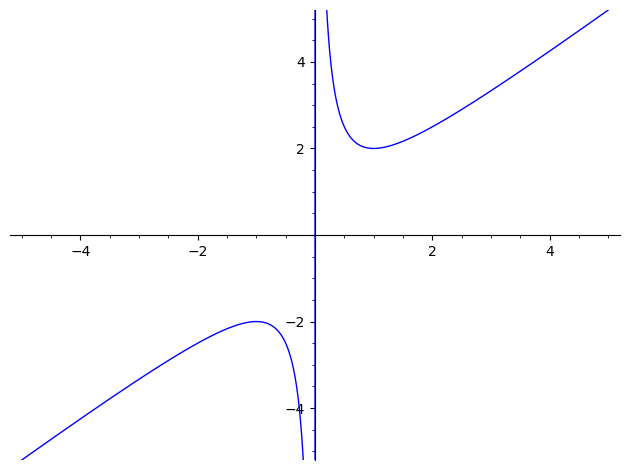

In [46]:
plot(w.substitute(a==1), ymin=-5, ymax=5, xmin=-5, xmax=5)

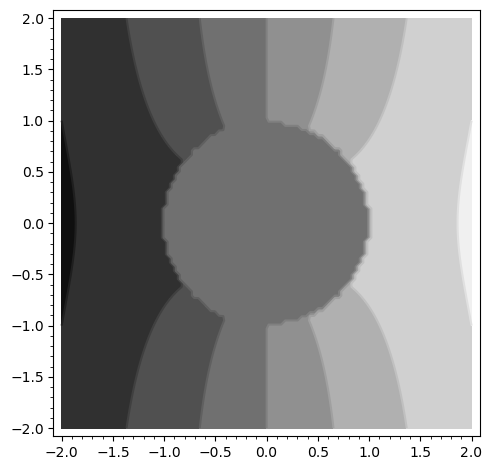

In [80]:
mask= unit_step(abs(x + y * i) - 1)

z = x + i * y
pot = u0 * w(z) # + 1/2 * i * log(z) look at d'alemberts paradox, stokes' paradox

Phi = real(pot)
Psi = imag(pot)
contour_plot((Phi * mask).substitute(a==1, u0==1), xrange=[-2, 2], yrange=[-2, 2])

In [81]:
u1 = derivative(Phi, x)
u2 = derivative(Phi, y)

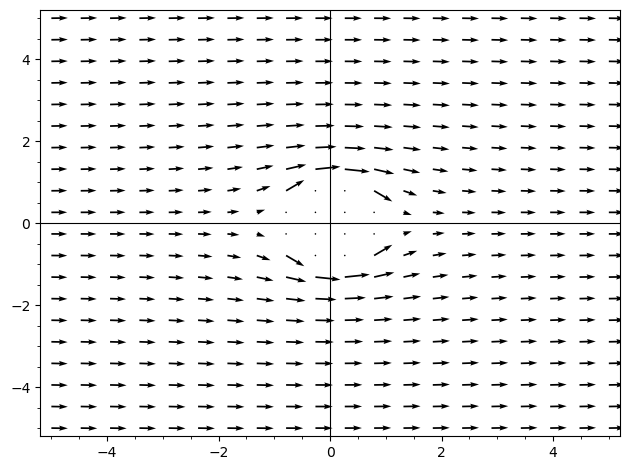

In [82]:
plot_vector_field((vector((u1, u2)) * mask).substitute(u0==1).substitute(a==1), xrange=(-5, 5), yrange=(-5, 5))

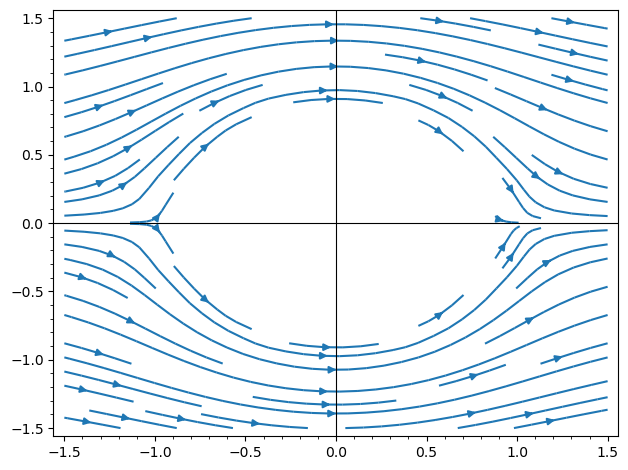

In [83]:
zoom = 1.5
streamline_plot(((u1 * mask).substitute(a==1, u0==1), (u2 * mask).substitute(a==1, u0==1)), xrange=(-zoom, zoom), yrange=(-zoom, zoom))

In [84]:
u1, u2

(-2*a^2*u0*x^2/(x^2 + y^2)^2 + a^2*u0/(x^2 + y^2) + u0,
 -2*a^2*u0*x*y/(x^2 + y^2)^2)

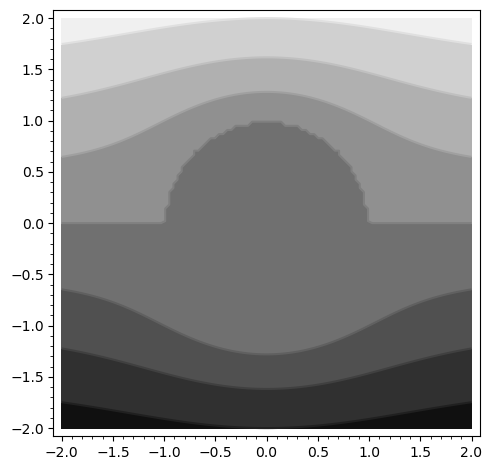

In [85]:
contour_plot((Psi * mask).substitute(a == 1, u0 == 1), xrange=(-2, 2), yrange=(-2, 2))

In [86]:
(Psi == A).solve(x)[0]

x == -sqrt(a^2*u0*y/(u0*y - A) - u0*y^3/(u0*y - A) + A*y^2/(u0*y - A))

In [87]:
A_ = Psi.substitute(x==L, y==beta)
A_

-a^2*beta*u0/(L^2 + beta^2) + beta*u0

In [88]:
trajectory = (Psi == A_).simplify_full().solve(x)[0]
X = trajectory.right()
trajectory

x == -sqrt(-L^2*a^2*y/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y) - a^2*beta^2*y/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y) - L^2*beta*y^2/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y) + a^2*beta*y^2/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y) - beta^3*y^2/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y) + L^2*y^3/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y) + beta^2*y^3/(L^2*beta - a^2*beta + beta^3 - L^2*y - beta^2*y))

In [89]:
conditions = (L == 2, beta== 1/8, a == 1, u0 == 1)

In [90]:
trajectory.substitute(conditions)

x == -sqrt(-2056*y^3/(2056*y - 193) + 193*y^2/(2056*y - 193) + 2056*y/(2056*y - 193))

verbose 0 (3885: plot.py, generate_plot_points) WARNING: When plotting, failed to evaluate function at 153 points.
verbose 0 (3885: plot.py, generate_plot_points) Last error message: 'Unable to compute f(4.0)'


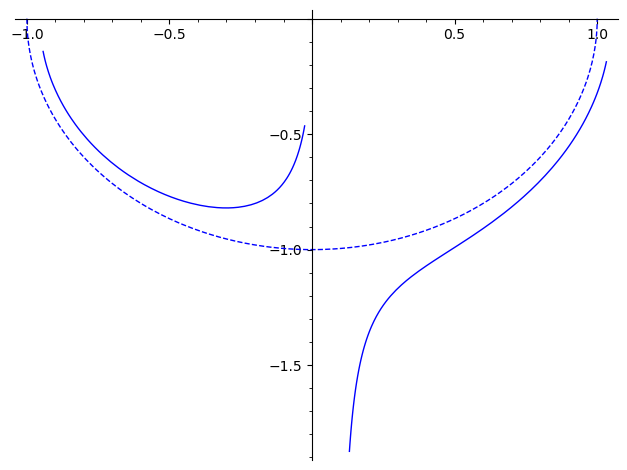

In [91]:
g = Graphics()
g += plot(trajectory.substitute(conditions).right(), y, -4, 4)
g += plot(-sqrt(1 - y^2), linestyle="--")
g

In [92]:
slns = (trajectory.right()^2 == 0).solve(y)
deflection = slns[1].right().simplify_full() - beta

deflection.simplify_full()

-1/2*(beta^3 + (L^2 + a^2)*beta - sqrt(4*L^4*a^2 + beta^6 + 2*(L^2 + a^2)*beta^4 + (L^4 + 6*L^2*a^2 + a^4)*beta^2))/(L^2 + beta^2)

In [93]:
deflection.substitute(L == 2, beta == 2, a==1).numerical_approx()

0.203768226591831

In [94]:
deflection.taylor(a, 0, 8)

-(5*L^6 + 5*L^4*beta^2 + L^2*beta^4)*a^8/(L^6*beta^7 + 3*L^4*beta^9 + 3*L^2*beta^11 + beta^13) + (2*L^4 + L^2*beta^2)*a^6/(L^4*beta^5 + 2*L^2*beta^7 + beta^9) - L^2*a^4/(L^2*beta^3 + beta^5) + L^2*a^2/(L^2*beta + beta^3)

In [95]:
def numerical_time_of_flight(*args):
    conditions_ = list(conditions)
    for arg in args:
        for i, cond in enumerate(conditions):
            if cond.left() == arg.left():
                conditions_[i] = (arg)

    return 2 * integral_numerical(
        (1 / u2.substitute(x==X)).substitute(conditions_), 
        beta.substitute(conditions_), 
        (beta + deflection).substitute(conditions_),
        algorithm="qags"
    )[0]


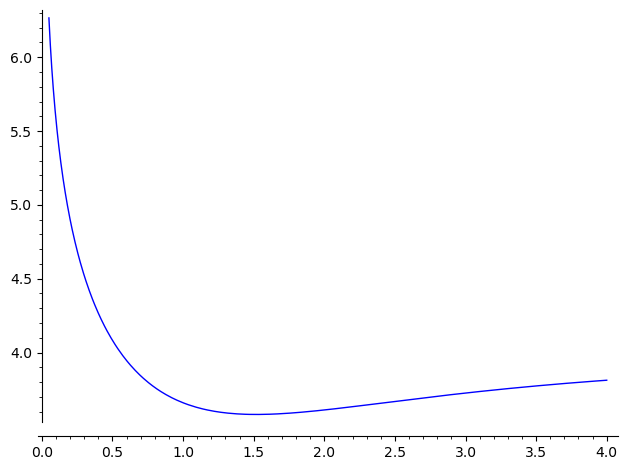

In [96]:
plot(lambda b: numerical_time_of_flight(beta==b), .05, 4)

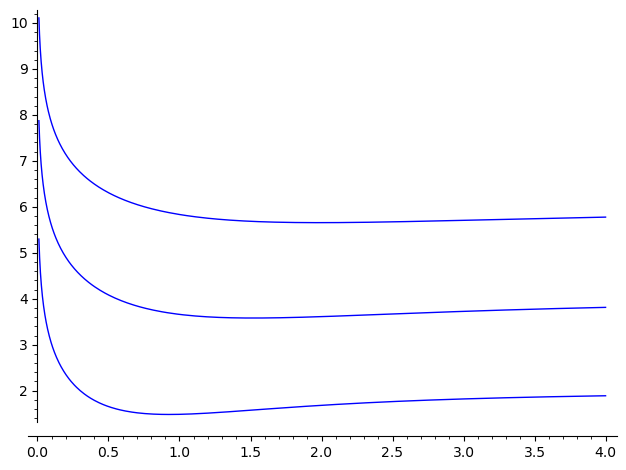

In [97]:
g = Graphics()
for LL in range(1, 4):
    g += plot(lambda b: numerical_time_of_flight(beta==b, L==LL), .01, 4)
g

verbose 0 (3885: plot.py, generate_plot_points) WARNING: When plotting, failed to evaluate function at 153 points.
verbose 0 (3885: plot.py, generate_plot_points) Last error message: 'Unable to compute f(4.0)'


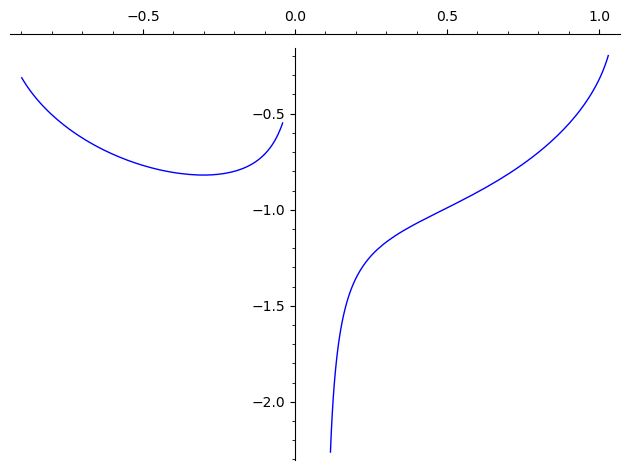

In [22]:
plot(trajectory.substitute(conditions).right(), y, -4, 4)


In [75]:
u1, u2

(-2*a^2*u0*x^2/(x^2 + y^2)^2 + a^2*u0/(x^2 + y^2) + u0 + 1/2*y/(x^2 + y^2),
 -2*a^2*u0*x*y/(x^2 + y^2)^2 - 1/2*x/(x^2 + y^2))

In [76]:
beta.substitute(conditions)

1/8

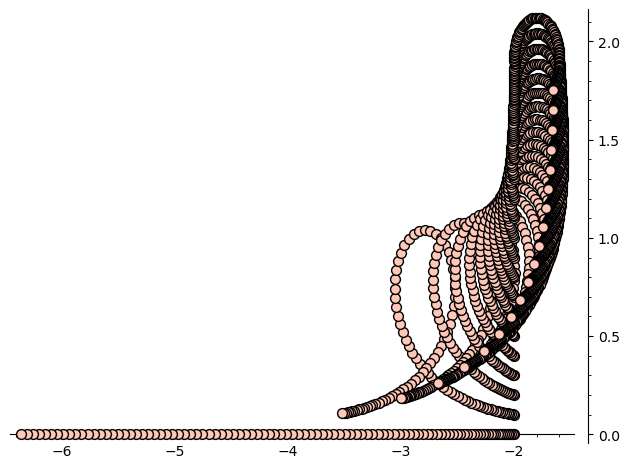

In [112]:
g = Graphics()
for beta_ in range(20):
    u1_ = u1.substitute(conditions)
    u2_ = u2.substitute(conditions)
    T=ode_solver()

    T.function = lambda t, vec: [u1_.substitute(x==vec[0], y==vec[1]), u2_.substitute(x==vec[0], y==vec[1])]
    T.y_0 = [-L.substitute(conditions), beta_ / 10]

    T.ode_solve(t_span=[0, numerical_time_of_flight()], num_points=100)
    g += scatter_plot([[p[1][0] - u0.substitute(conditions) * p[0], p[1][1]]for  p in T.solution])
g

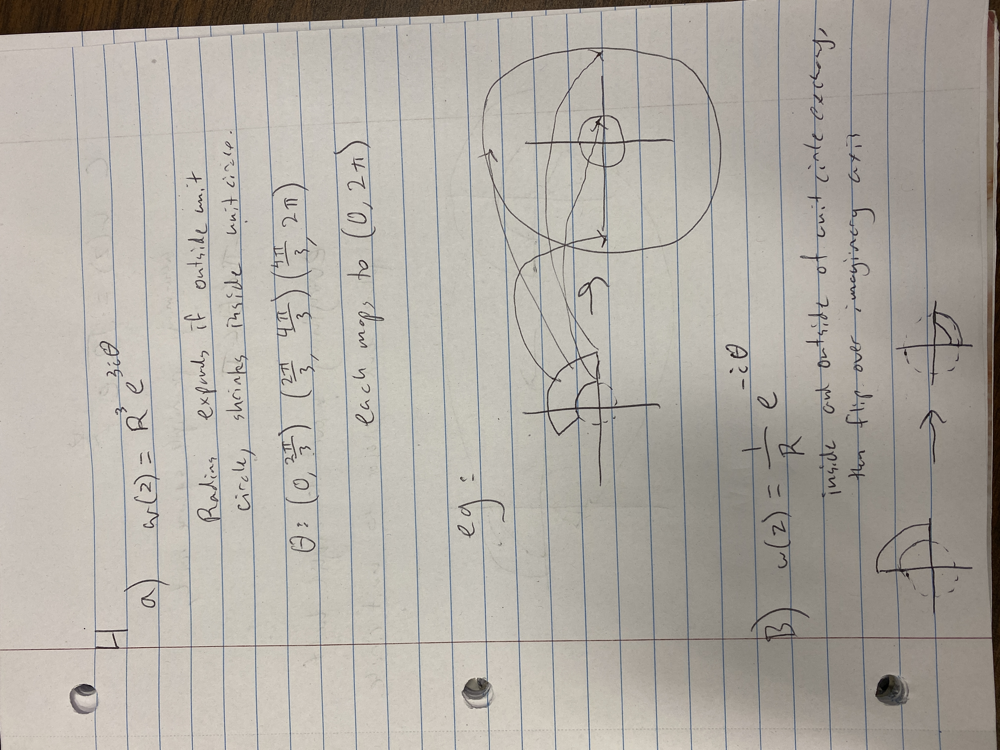

In [5]:
Image("/Users/hastings/Downloads/IMG_0925.JPG")

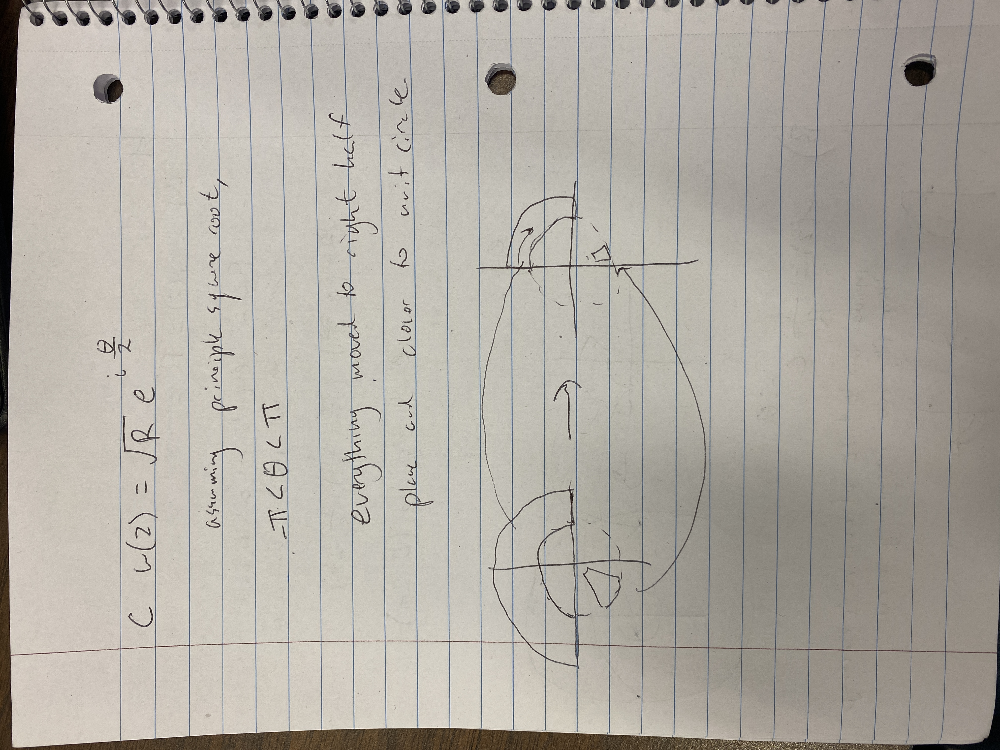

In [6]:
Image("/Users/hastings/Downloads/IMG_0926.JPG")

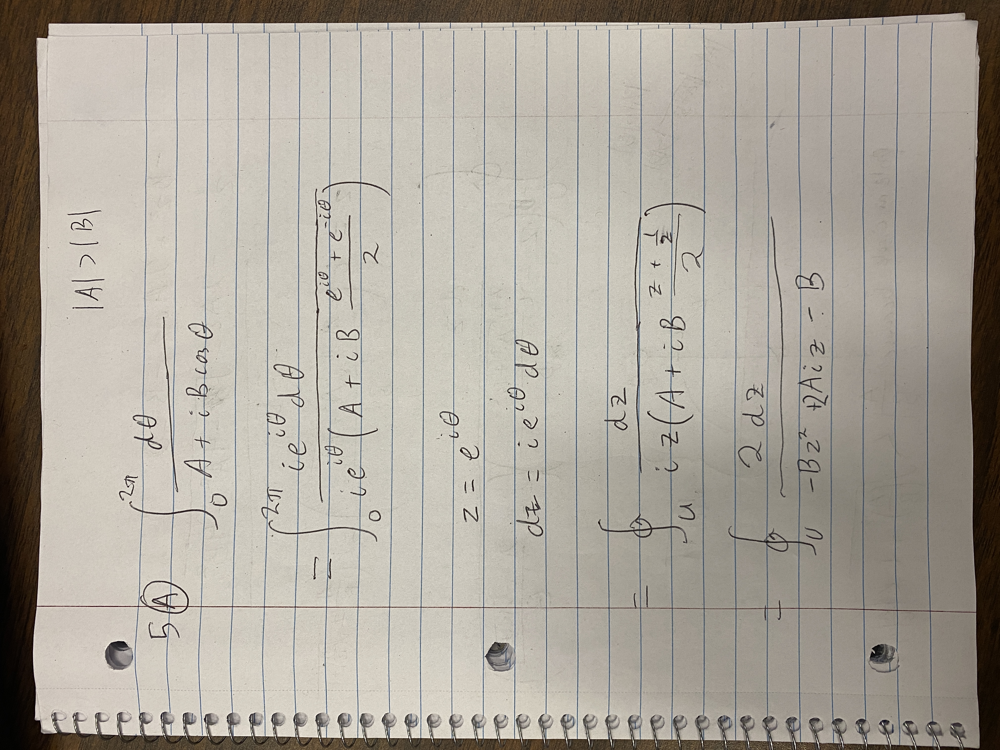

In [1]:
from IPython.display import Image
Image("/Users/hastings/Downloads/IMG_0921.JPG")

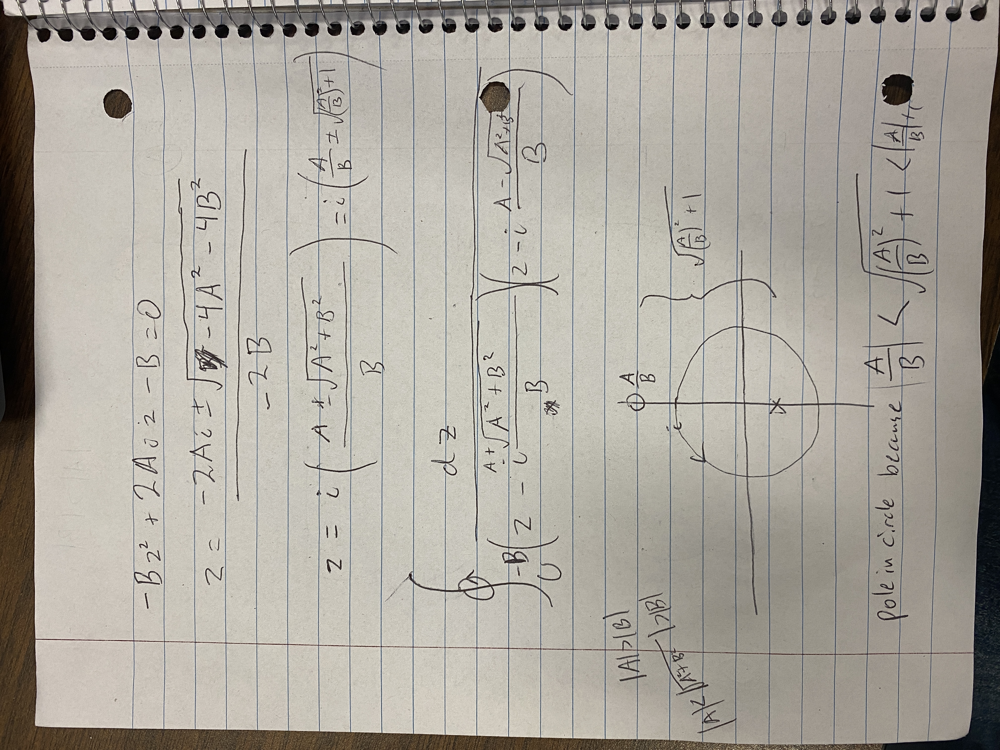

In [2]:
Image("/Users/hastings/Downloads/IMG_0922.JPG")

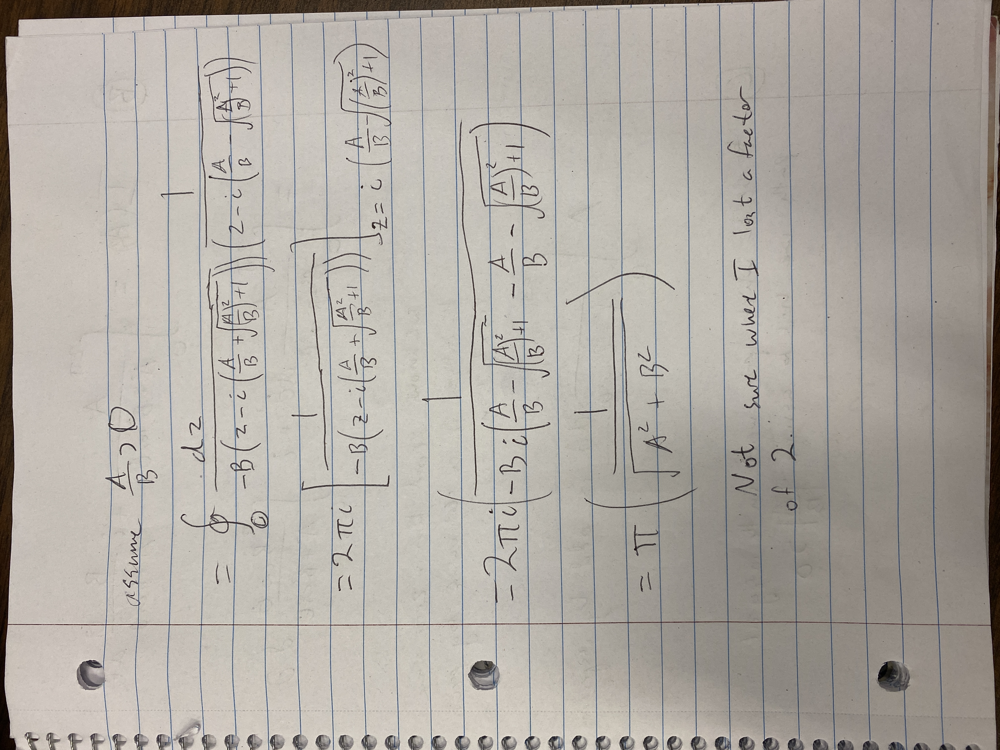

In [3]:
Image("/Users/hastings/Downloads/IMG_0923.JPG")

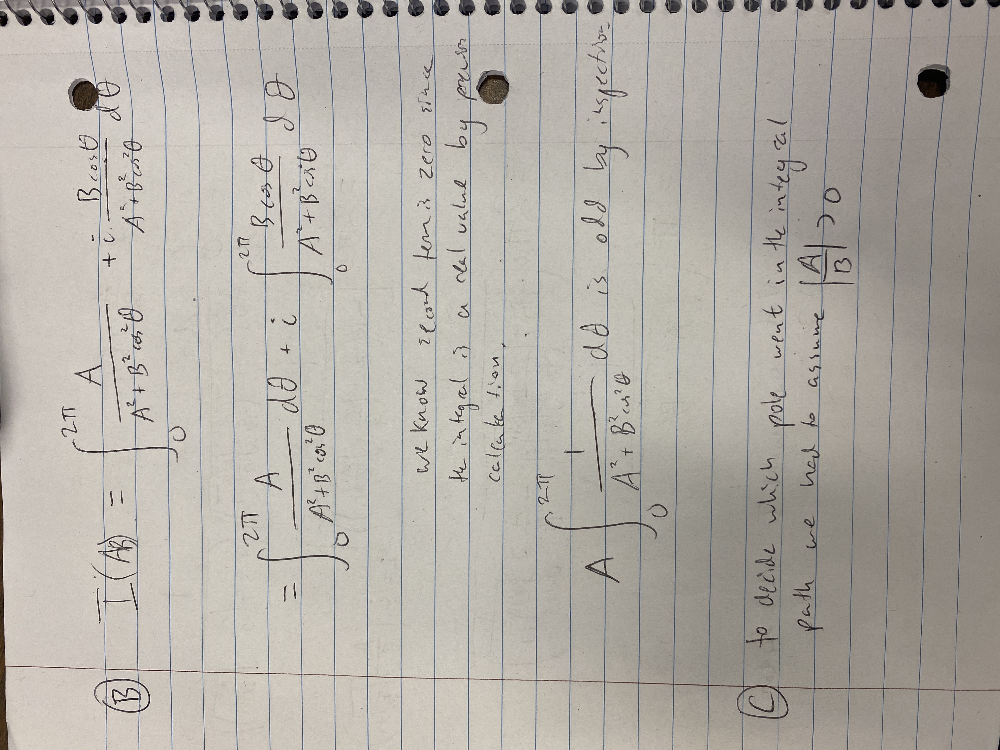

In [4]:
Image("/Users/hastings/Downloads/IMG_0924.JPG")